<font size='6'><b>Test source clustering</b></font>

# Init

In [1]:
import sys, os, h5py, bz2, pylab as plt, importlib, itertools
from tqdm.auto import tqdm, trange
from collections import OrderedDict
from IPython.display import set_matplotlib_formats
import seaborn
from ipywidgets import interactive, fixed
set_matplotlib_formats('retina')
plt.style.use('dark_background')
# plt.style.use('default')
%pylab inline
%load_ext autoreload
%autoreload 2
if 'notebooks' in os.getcwd(): os.chdir('..')
print(os.getcwd())

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib
/Users/tomaszk/Archive/projects/220708_cosmogrid_paper/005_cosmogridv11


/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_33528/353435859.py:7: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('retina')
/Users/tomaszk/pyvenv/miniconda3/envs/tfm1230624/lib/python3.10/site-packages/IPython/core/magics/pylab.py:162: UserWarning: pylab import has clobbered these variables: ['interactive', 'plt']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [2]:
import healpy as hp


# Plot source clustering maps

## download

In [78]:
host = 'euler'
path = '/cluster/work/refregier/tomaszk/projects/220708_cosmogrid_paper/005_cosmogridv11/'

In [353]:
!rsync -avR {host}:{path}/./CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/perm_0000/projected_probes_maps_nobaryons512.h5 . 
!rsync -avR {host}:{path}/./CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/probe_weights.h5 . 

receiving file list ... done

sent 16 bytes  received 274 bytes  580.00 bytes/sec
total size is 42210635  speedup is 145553.91
receiving file list ... done

sent 16 bytes  received 232 bytes  496.00 bytes/sec
total size is 9976  speedup is 40.23


In [354]:
with h5py.File('CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/perm_0000/projected_probes_maps_nobaryons512.h5', 'r') as f:
    kg = np.array(f['kg/stage3_lensing1'])
    dg = np.array(f['dg/stage3_lensing1'])
    kd = np.array(f['kd/stage3_lensing1'])

In [356]:
with h5py.File('CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/probe_weights.h5', 'r') as f:
    w_kg = np.array(f['kg/stage3_lensing1'])
    w_dg = np.array(f['dg/stage3_lensing1'])
    # w_cmb_k = np.array(f['k_cmb/cmb'])

# plot kernel

[None, Text(0, 0.5, 'cmb_k kernel')]

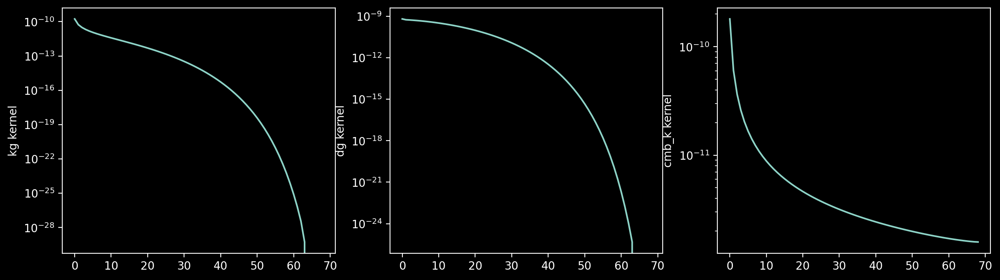

In [390]:
nx, ny = 1, 3; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
axl[0].plot(w_kg)
axl[0].set(yscale='log', ylabel='kg kernel')
axl[1].plot(w_dg)
axl[1].set(yscale='log', ylabel='dg kernel')
axl[2].plot(w_cmb_k)
axl[2].set(yscale='log', ylabel='cmb_k kernel')

# load weights (kg_split)

In [1043]:
!rsync -avR {host}:{path}/./CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/probe_weights.h5 .

receiving file list ... done

sent 16 bytes  received 232 bytes  496.00 bytes/sec
total size is 141864  speedup is 572.03


In [39]:
with h5py.File('CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/probe_weights.h5', 'r') as f:
    kg_split = np.array(f['kg_split/stage3_lensing1'])
    weight_dg = np.array(f['dg/stage3_lensing1'])

/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_33528/2301023062.py:3: RuntimeWarning: divide by zero encountered in log
  axl[1].pcolormesh(np.log(kg_split).T, cmap='Spectral_r')
/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_33528/2301023062.py:3: RuntimeWarning: invalid value encountered in log
  axl[1].pcolormesh(np.log(kg_split).T, cmap='Spectral_r')


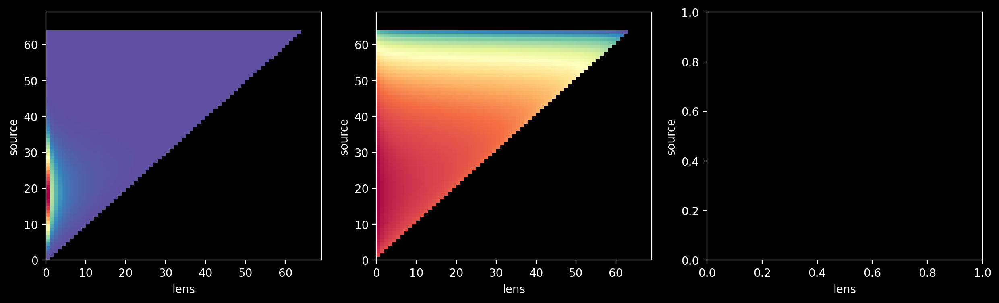

In [97]:
nx, ny = 1, 3; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
axl[0].pcolormesh(np.ma.array(kg_split, mask=kg_split==0).T, cmap='Spectral_r')
axl[1].pcolormesh(np.log(kg_split).T, cmap='Spectral_r')
for a in axl.ravel():
    a.set(xlabel='lens', ylabel='source')

/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_64489/3301400850.py:8: RuntimeWarning: invalid value encountered in true_divide
  axl[2].plot((w_kg-np.sum(kg_split, axis=1))/w_kg)


[(-0.1, 0.1), Text(0.5, 0, 'shell id')]

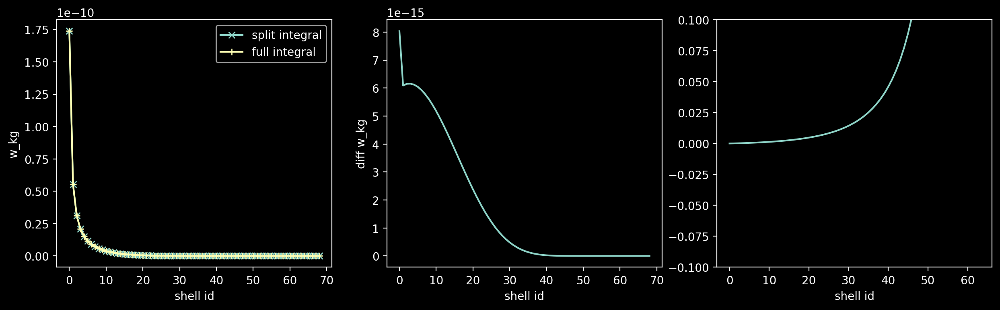

In [1049]:
nx, ny = 1, 3; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
axl[0].plot(np.sum(kg_split, axis=1), 'x-', label='split integral')
axl[0].plot(w_kg, '+-', label='full integral')
axl[0].set(xlabel='shell id', ylabel='w_kg')
axl[0].legend()
axl[1].plot(w_kg-np.sum(kg_split, axis=1))
axl[1].set(xlabel='shell id', ylabel='diff w_kg')
axl[2].plot((w_kg-np.sum(kg_split, axis=1))/w_kg)
axl[2].set(ylim=[-0.1, 0.1], xlabel='shell id')

# plot all weights

In [11]:
def pcolormesh_cbar(ax, arr, **kwargs):
    cb = ax.pcolormesh(arr, **kwargs)
    ax.get_figure().colorbar(cb, ax=ax)

/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_33528/1913374824.py:11: RuntimeWarning: divide by zero encountered in log10
  pcolormesh_cbar(axl[i], np.log10(np.ma.array(kg_split, mask=kg_split==0).T), cmap='Spectral_r')
/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_33528/1913374824.py:11: RuntimeWarning: invalid value encountered in log10
  pcolormesh_cbar(axl[i], np.log10(np.ma.array(kg_split, mask=kg_split==0).T), cmap='Spectral_r')


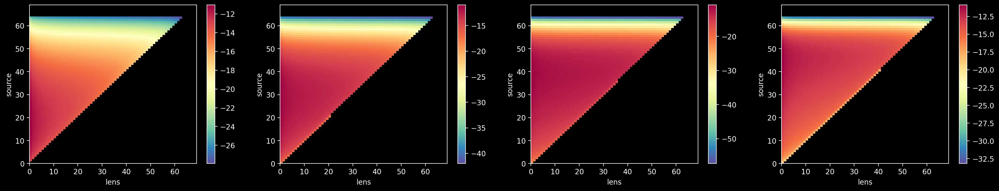

In [443]:
n_zbins = 4
list_kg_split = []
with h5py.File('CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/probe_weights.h5', 'r') as f:
    for i in range(n_zbins):
        kg_split = np.array(f[f'kg_split/stage3_lensing{i+1}'])
        list_kg_split.append(kg_split)
    
nx, ny = 1, n_zbins; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.5, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
for i in range(n_zbins):
    kg_split = list_kg_split[i]
    pcolormesh_cbar(axl[i], np.log10(np.ma.array(kg_split, mask=kg_split==0).T), cmap='Spectral_r')
    axl[i].set(xlabel='lens', ylabel='source')

# prototype source clustering map

In [525]:
def smooth(m, sig_arcmin=8):
    return hp.smoothing(m, sigma=np.deg2rad(sig_arcmin/60))    

In [526]:
!rsync -avR {host}:{path}/./map_kd.npy .

receiving file list ... done
map_kd.npy

sent 30146 bytes  received 25172248 bytes  16801596.00 bytes/sec
total size is 25165952  speedup is 1.00


In [527]:
map_kd = np.load('map_kd.npy')
# map_kd = smooth(map_kd, sig_arcmin=16)

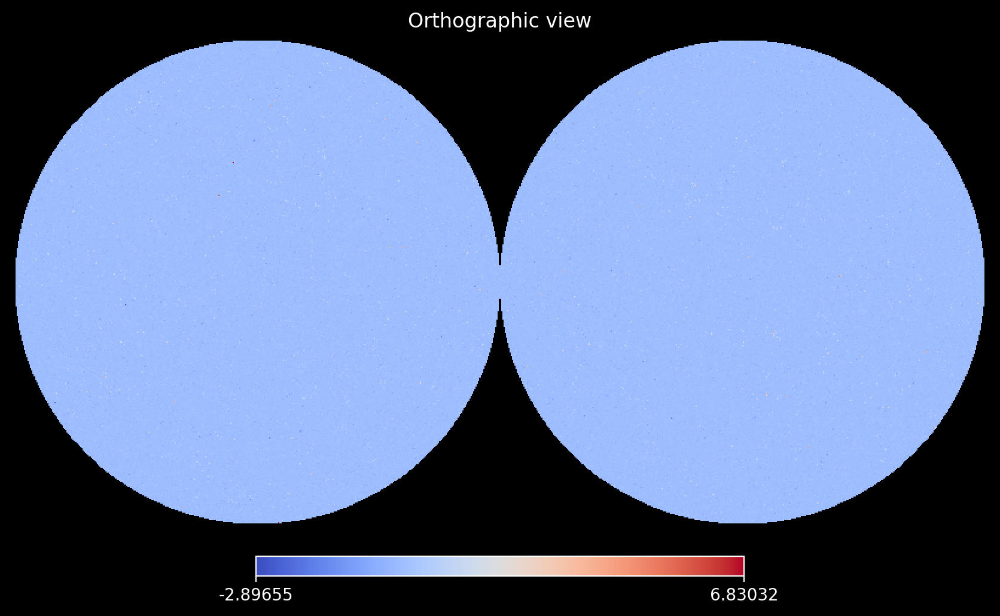

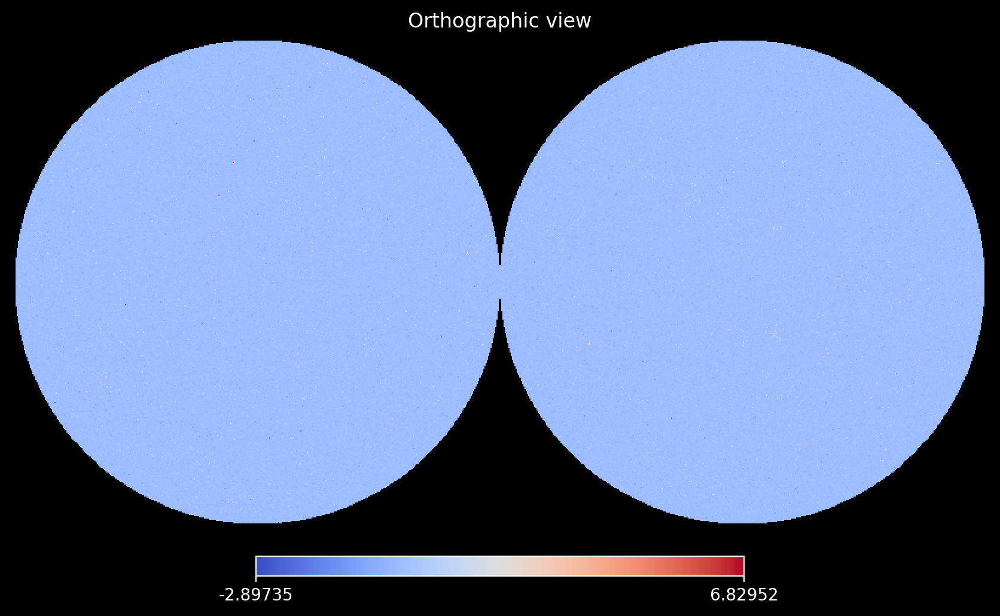

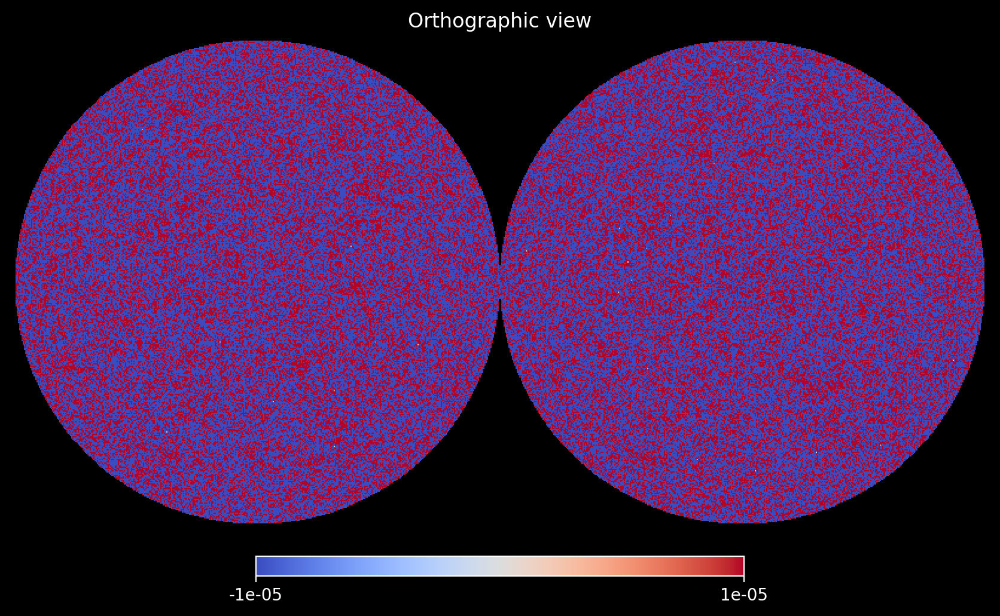

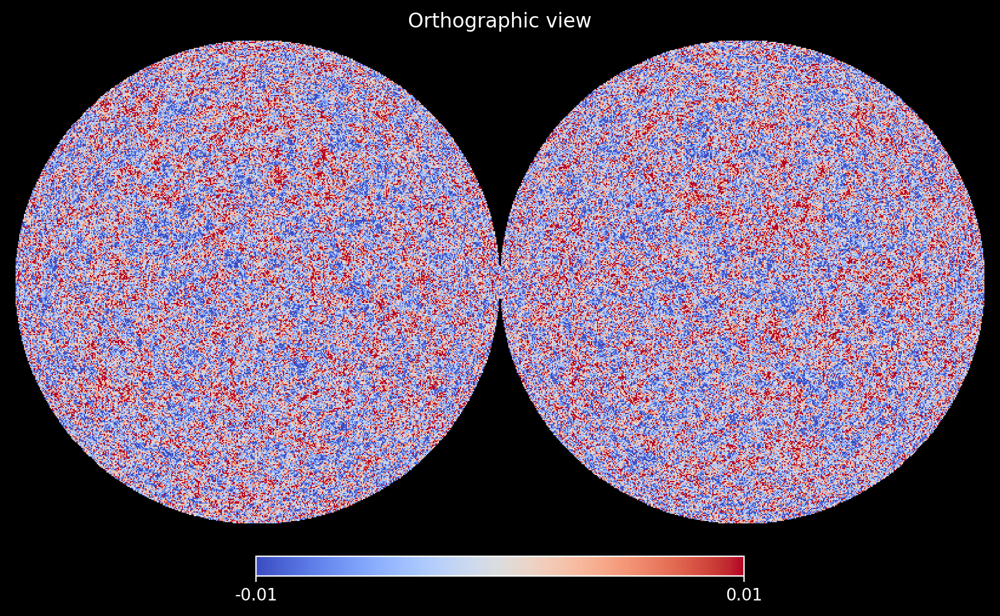

In [529]:
hp.orthview(map_kd, cmap='coolwarm', bgcolor='black')
hp.orthview(map_kd-np.mean(map_kd), cmap='coolwarm', bgcolor='black')
hp.orthview(map_kd-np.mean(map_kd), cmap='coolwarm', bgcolor='black', min=-1e-5, max=1e-5)
hp.orthview(kg-np.mean(kg), cmap='coolwarm', bgcolor='black', min=-0.01, max=0.01)

# check the maps file

In [591]:
def get_map_with_sc(kg, dg, kd, b_gal=1, nz_norm=1):

    # n = 1 + b_gal * (dg/np.mean(dg)-1)
    # kg_sc = (kg/nz_norm + b_gal * kd)/(n/nz_norm)
    # kg_sc = (kg/nz_norm)/(n/nz_norm)
    kg_sc = (kg + b_gal * kd)
    # kg_sc = kd/n
    return kg_sc

In [592]:
def smooth(m, sig_arcmin=8):
    return hp.smoothing(m, sigma=np.deg2rad(sig_arcmin/60))  

In [593]:
!rsync -avR {host}:{path}/./CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/perm_0000/projected_probes_maps_nobaryons512.h5 .

receiving file list ... done
CosmoGrid/test_sc/CosmoGrid/test/fiducial/

sent 22 bytes  received 284 bytes  204.00 bytes/sec
total size is 177219046  speedup is 579147.21


In [579]:
id_zbin = 1
with h5py.File('CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/perm_0000/projected_probes_maps_nobaryons512.h5', 'r') as f:
    kg = np.array(f[f'kg/stage3_lensing{id_zbin}'])
    kd = np.array(f[f'kd/stage3_lensing{id_zbin}'])
    dg = np.array(f[f'dg/stage3_lensing{id_zbin}'])


In [580]:
kg = smooth(kg)
dg = smooth(dg)
kd = smooth(kd)

In [581]:
kg_sc = get_map_with_sc(kg, dg, kd, b_gal=2, nz_norm=1)

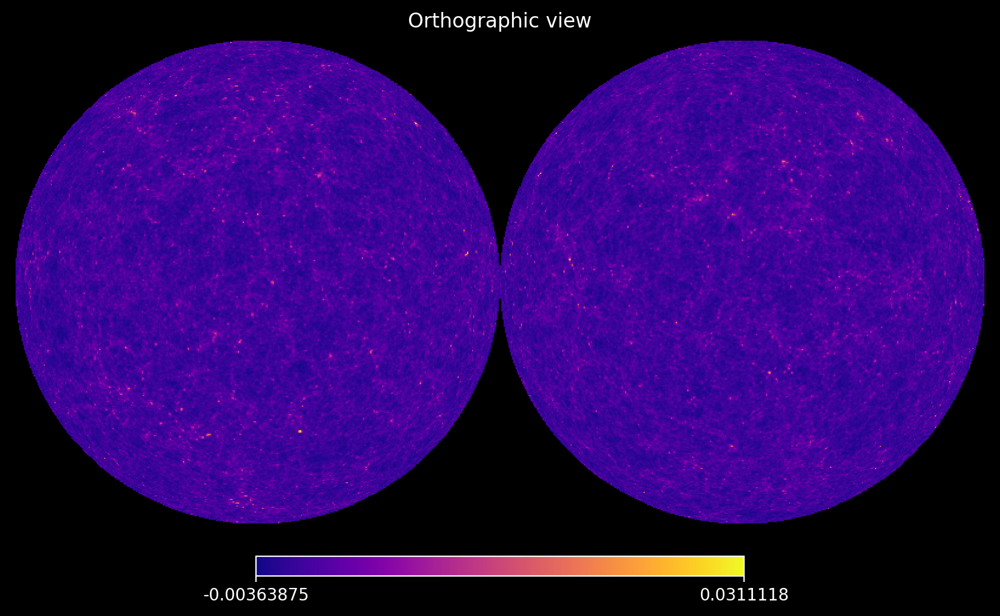

In [582]:
hp.orthview(kg-np.mean(kg), cmap='plasma', bgcolor='black')

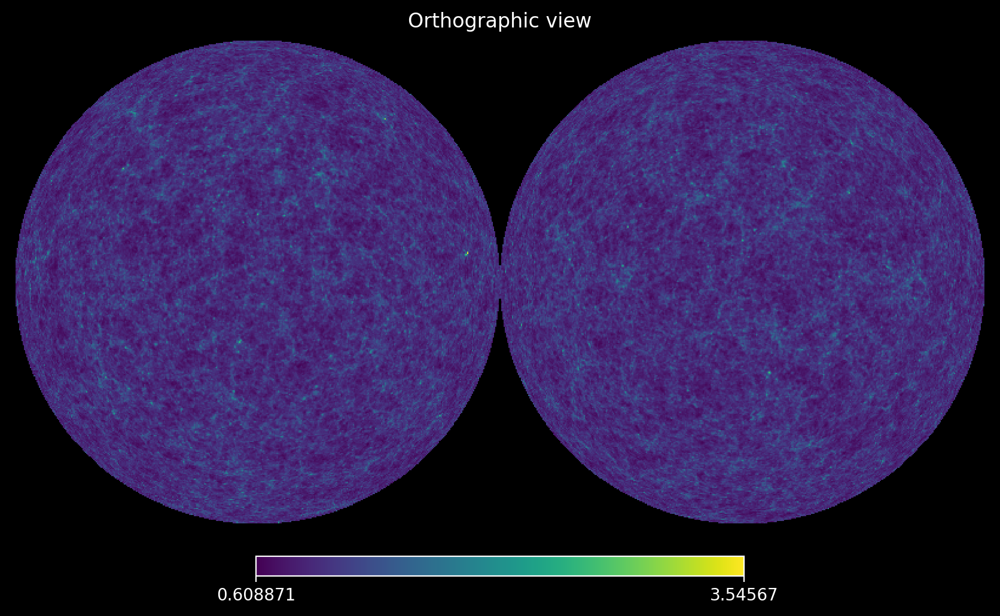

In [583]:
hp.orthview(dg, cmap='viridis', bgcolor='black')

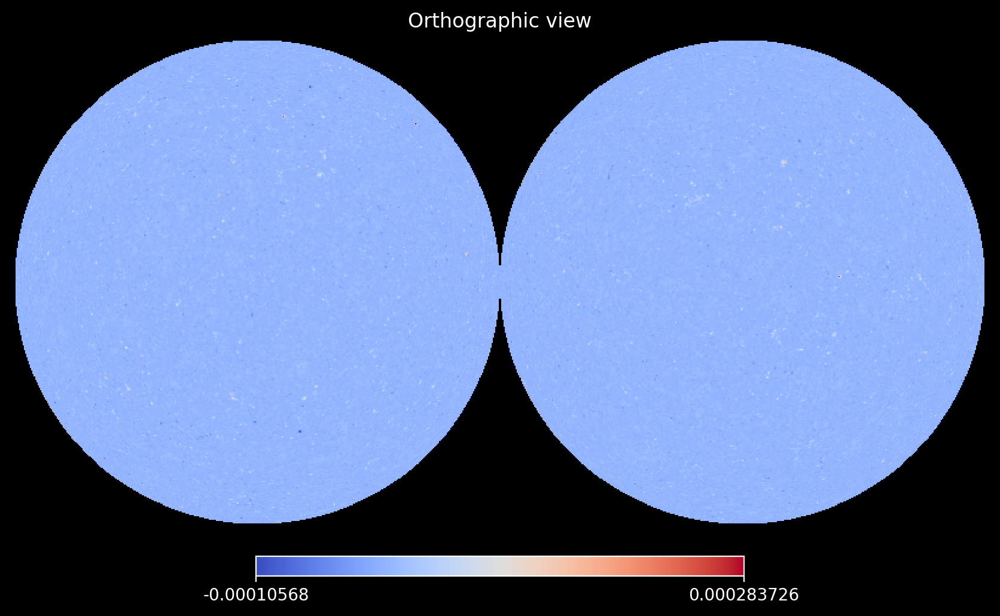

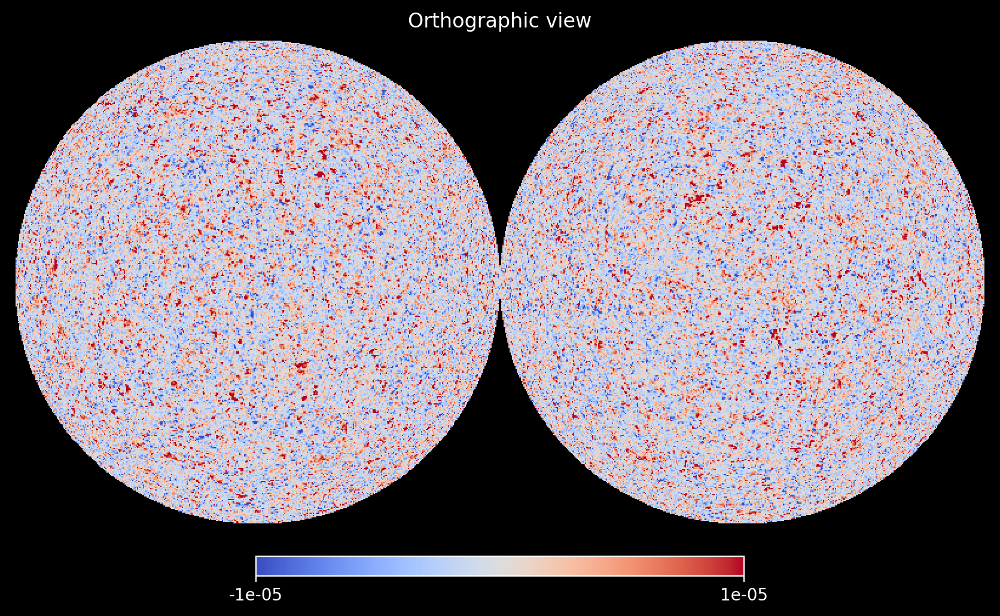

In [584]:
hp.orthview(kd, cmap='coolwarm', bgcolor='black')
hp.orthview(kd, cmap='coolwarm', bgcolor='black', min=-0.00001, max=0.00001)

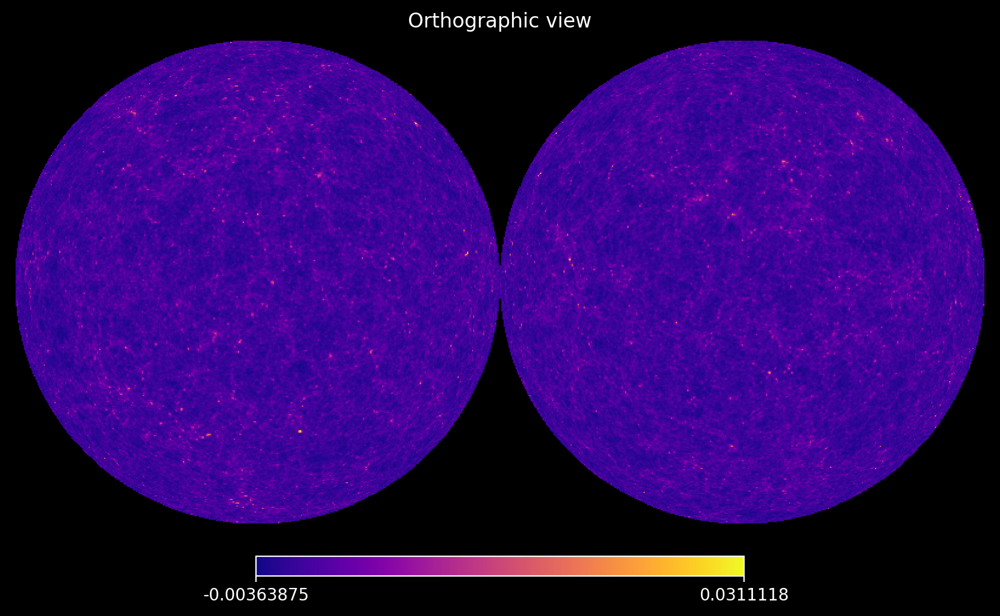

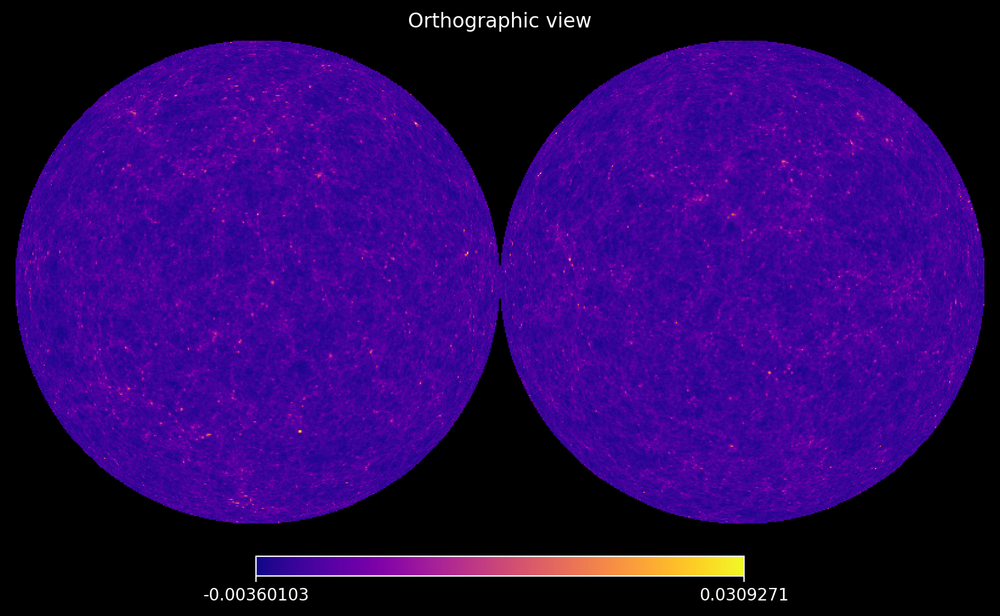

In [585]:
hp.orthview(kg-np.mean(kg), cmap='plasma', bgcolor='black')
hp.orthview(kg_sc-np.mean(kg_sc), cmap='plasma', bgcolor='black')

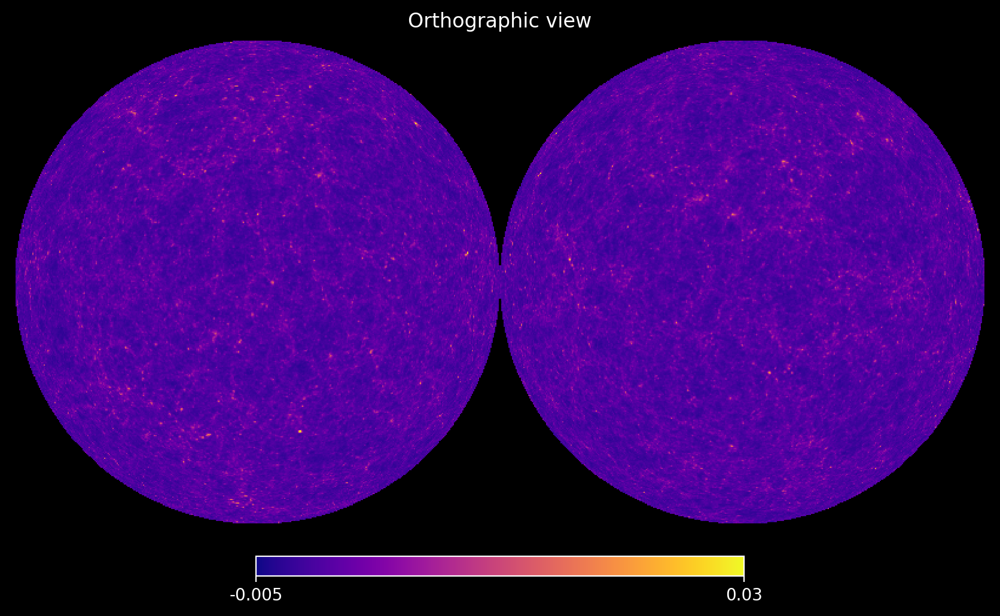

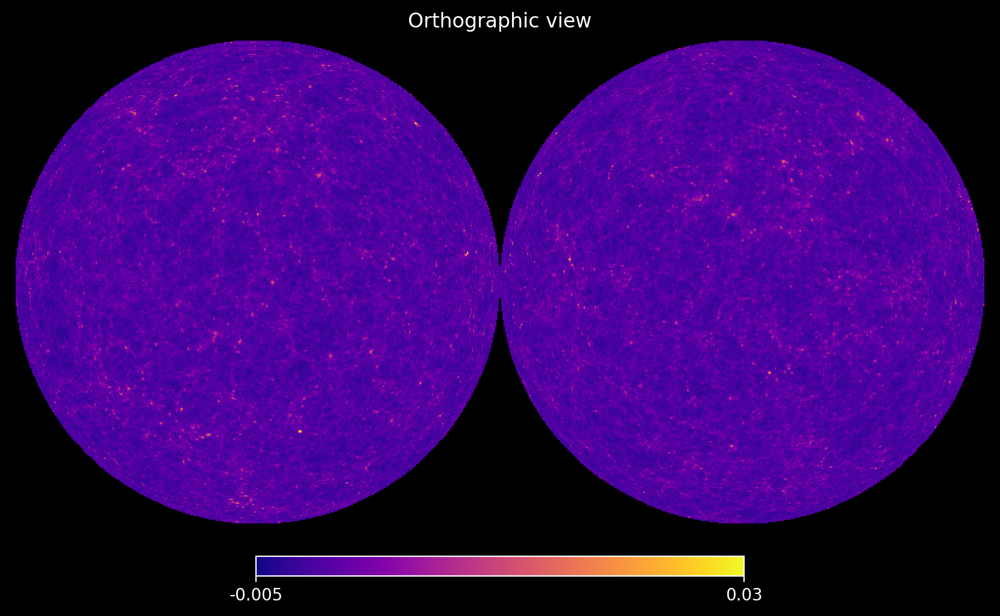

In [586]:
kg_lims = dict(min=-0.005, max=0.03)
hp.orthview(kg-np.mean(kg), cmap='plasma', bgcolor='black', **kg_lims)
hp.orthview(kg_sc-np.mean(kg_sc), cmap='plasma', bgcolor='black', **kg_lims)

## plot difference with / without sc

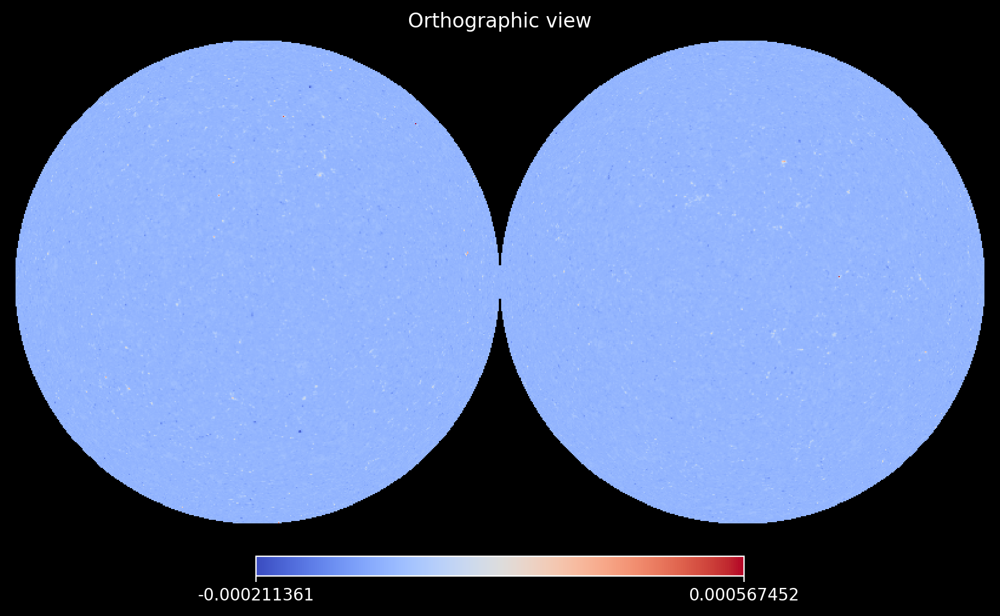

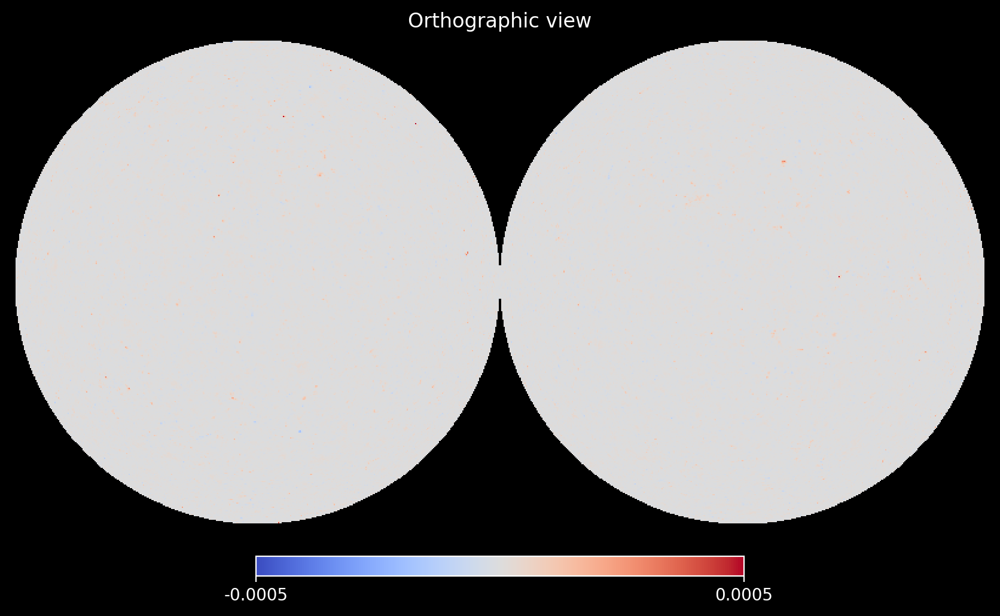

In [587]:
hp.orthview(kg_sc-kg, cmap='coolwarm', bgcolor='black')
hp.orthview((kg_sc-np.mean(kg_sc))-(kg-np.mean(kg)), cmap='coolwarm', bgcolor='black', min=-0.0005, max=0.0005)

# plot Cls

In [588]:
def get_bin_maps(id_zbin, b_gal=1, smooth_arcmin=8):
    
    with h5py.File('CosmoGrid/test_sc/CosmoGrid/test/fiducial/cosmo_fiducial/perm_0000/projected_probes_maps_nobaryons512.h5', 'r') as f:
        kg = np.array(f[f'kg/stage3_lensing{id_zbin+1}'])
        kd = np.array(f[f'kd/stage3_lensing{id_zbin+1}'])
        dg = np.array(f[f'dg/stage3_lensing{id_zbin+1}'])

    kg = smooth(kg, smooth_arcmin)
    dg = smooth(dg, smooth_arcmin)
    # kd = smooth(kd, smooth_arcmin)
    kd = smooth(kd, smooth_arcmin)

    kg_sc = get_map_with_sc(kg, dg, kd, b_gal=b_gal, nz_norm=1)

    return kg_sc, kg, kd, dg


In [589]:
def scale_cls(c):
    ells = np.arange(len(c))
    return ells, ells*(ells+1)*c/(np.pi*2)

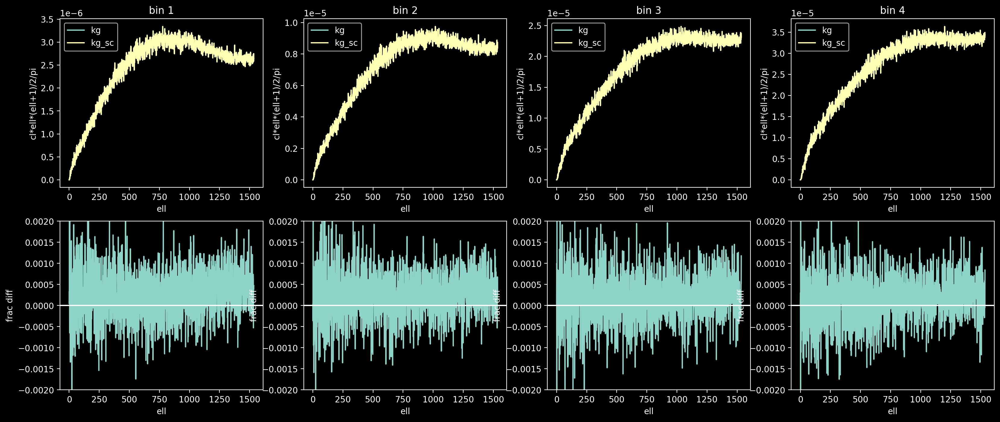

In [590]:
n_zbins=4
nx, ny = 2, 4; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
for i in range(n_zbins):
    kg_sc, kg, kd, dg = get_bin_maps(i, b_gal=2, smooth_arcmin=1)
    cls_kg = hp.alm2cl(hp.map2alm(kg))
    cls_kg_sc = hp.alm2cl(hp.map2alm(kg_sc))
    ax[0,i].plot(*scale_cls(cls_kg), label='kg')
    ax[0,i].plot(*scale_cls(cls_kg_sc), label='kg_sc')
    ax[1,i].plot(cls_kg_sc/cls_kg-1, label='kg_sc')
    ax[0,i].set(ylabel='cl*ell*(ell+1)/2/pi', xlabel='ell')
    ax[1,i].set(ylim=[-0.002, 0.002], ylabel='frac diff', xlabel='ell')
    ax[1,i].axhline(0)
    ax[0,i].legend()
    ax[0,i].set(title=f'bin {i+1}')

# plot all maps

In [516]:
nx, ny = 3, n_zbins; figsize=10; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 2, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];

for i in trange(n_zbins):

    kg_sc, kg, kd, dg = get_bin_maps(i, smooth_arcmin=16)

    plt.axes(ax[0,i])
    hp.orthview(dg-1, cmap='coolwarm', bgcolor='black', hold=True, title=f'clustering bin {i+1}')
    plt.axes(ax[1,i])
    hp.orthview((kg - np.mean(kg)), cmap='plasma', bgcolor='black', hold=True, title=f'convergence bin {i+1}')    
    plt.axes(ax[2,i])
    hp.orthview((kd - np.mean(kd)), cmap='coolwarm', bgcolor='black', min=-0.00001, max=0.00001, hold=True, title=f'source clustering bin {i+1}')

fig.savefig('source_clustering.pdf')

  0%|          | 0/4 [00:00<?, ?it/s]

In [519]:
np.std(kd), np.std(kg), np.std(kd)/np.std(kg)

(3.2803633086813604e-06, 0.004014625216357709, 0.0008171032492187373)

# regression test for baryonification

In [1178]:
!rsync -av tomaszk@login.phys.ethz.ch:/home/ipa/refreg/data/data_products/CosmoGrid/stage3_forecast/fiducial/cosmo_fiducial/perm_0000/projected_probes_maps_nobaryons512.h5 .

receiving file list ... done

sent 16 bytes  received 121 bytes  91.33 bytes/sec
total size is 122154778  speedup is 891640.72


In [14]:
with h5py.File('projected_probes_maps_nobaryons512.h5', 'r') as f: 
    kg_orig = np.array(f['kg/stage3_lensing1'])

In [787]:
kg_orig = smooth(kg_orig)

In [788]:
cls_orig = hp.alm2cl(hp.map2alm(kg_orig))

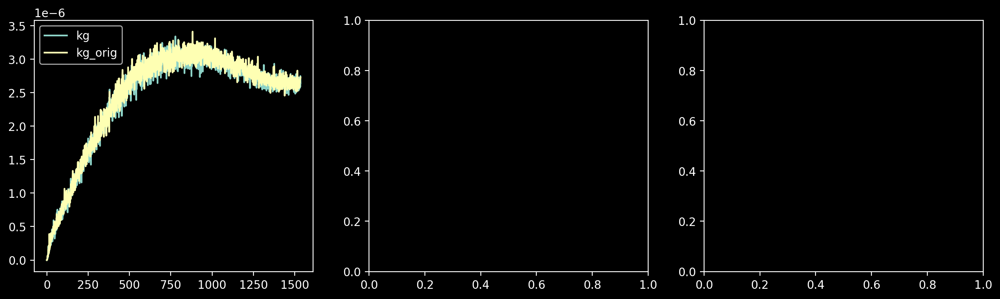

In [789]:
nx, ny = 1, 3; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
axl[0].plot(*scale_cls(cls_kg), label='kg')
axl[0].plot(*scale_cls(cls_orig), label='kg_orig')
axl[0].legend()

# look at each shell separately

In [1077]:
! rsync -av --progress {host}:/cluster/work/refregier/tomaszk/projects/220708_cosmogrid_paper/005_cosmogridv11/test_data.h5 .

receiving file list ... 
1 file to consider
test_data.h5
   422086485 100%    6.93MB/s    0:00:58 (xfer#1, to-check=0/1)

sent 38 bytes  received 422189687 bytes  7216918.38 bytes/sec
total size is 422086485  speedup is 1.00


In [396]:
with h5py.File('test_data.h5', 'r') as f:
        shells = np.array(f['shells'])
        weight = np.array(f['weight'])
        m = np.array(f['m'])
        prefactor_sim = np.array(f['prefactor_sim'])
    

In [51]:
shells_lr = hp.ud_grade(shells, nside_out=256, power=-2)

In [52]:
nom_kg = np.zeros(shells_lr.shape[1])
den_kg = np.zeros(shells_lr.shape[1])
list_cls = np.empty((len(shells), len(shells)), dtype=object)
arr_var = np.zeros((len(shells), len(shells)))
arr_xcor = np.zeros((len(shells), len(shells)))
for i in trange(0, len(shells)):
    
    si = shells_lr[i].astype(np.float64)
    
    # sum over source shells
    for j in range(i, len(shells)):

        sj = si if i==j else shells_lr[j].astype(np.float64)

        delta = sj/np.mean(sj) - 1.

        m = weight[i,j] * (1+delta) * si * prefactor_sim
        n = (1+delta) 

        nom_kg += m
        den_kg += n 

        arr_var[i,j] = np.sqrt(np.mean(m**2))
        arr_xcor[i,j] = np.mean((delta-np.mean(delta))*(si-np.mean(si)))/np.sqrt(np.var(delta)*np.var(si))

        # cls_m = hp.alm2cl(hp.map2alm(m))

        # list_cls[i,j] = cls_m

map_kg = nom_kg/den_kg

  0%|          | 0/69 [00:00<?, ?it/s]

0.0027481352
0.0027231602
0.0012745557
0.0016534295
4.0338771706376214e-06


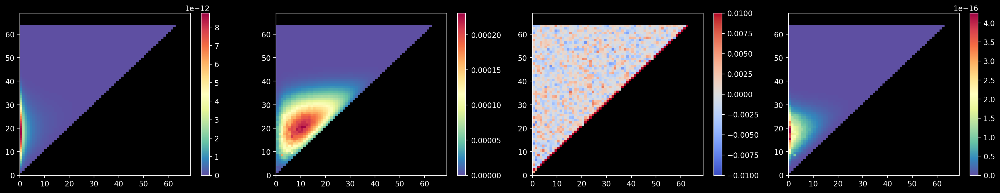

In [60]:
nx, ny = 1, 4; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.5, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
pcolormesh_cbar(axl[0], np.ma.array(weight, mask=weight==0).T, cmap='Spectral_r')
pcolormesh_cbar(axl[1], np.ma.array(arr_var, mask=arr_var==0).T, cmap='Spectral_r')
pcolormesh_cbar(axl[2], np.ma.array(arr_xcor, mask=arr_var==0).T, cmap='coolwarm', vmin=-0.01, vmax=0.01)
pcolormesh_cbar(axl[3], np.ma.array(weight*arr_var, mask=arr_var==0).T, cmap='Spectral_r')
print(np.std(kg_orig))
print(np.std(kg))
print(np.std(kg_sc))
print(np.std(kd))
print(np.std(map_kg))

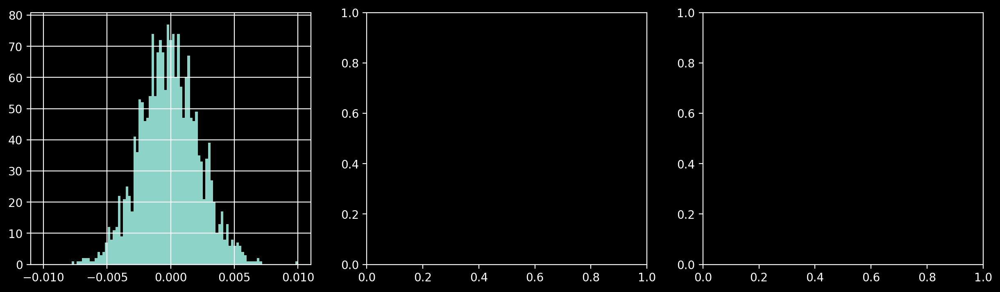

In [67]:
nx, ny = 1, 3; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
axl[0].hist(arr_xcor[arr_var!=0].ravel(), bins=np.linspace(-0.01, 0.01, 100));
axl[0].grid(True)

In [61]:
np.sum(weight*arr_var)

2.4604452106437165e-14

In [54]:
np.sqrt(np.sum(arr_var**2))

0.0028660647038848412

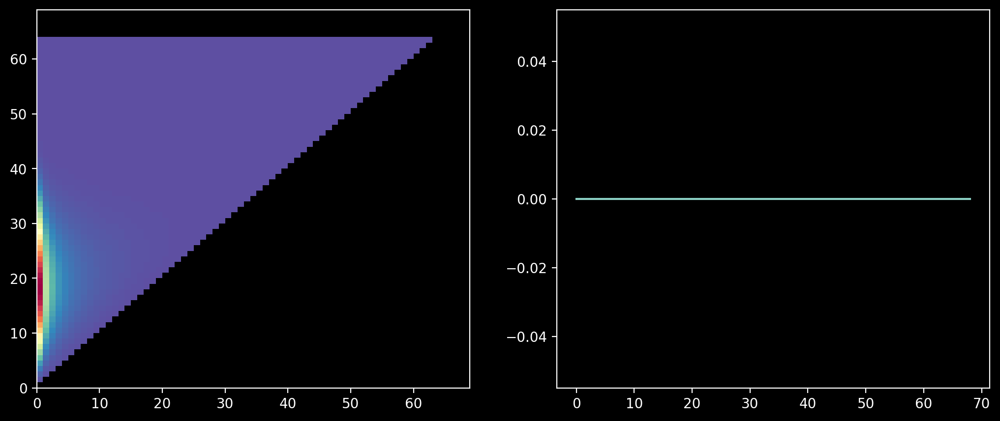

In [55]:
nx, ny = 1, 2; figsize=5; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
axl[0].pcolormesh(np.ma.array(weight, mask=weight==0).T, cmap='Spectral_r')
axl[1].plot(np.diag(weight))

In [56]:
list_cls_valid = []
for cls in list_cls.ravel():
    if cls is not None:
        list_cls_valid.append(cls)
list_cls_valid = np.array(list_cls_valid)
list_cls_valid.shape

(0,)

217


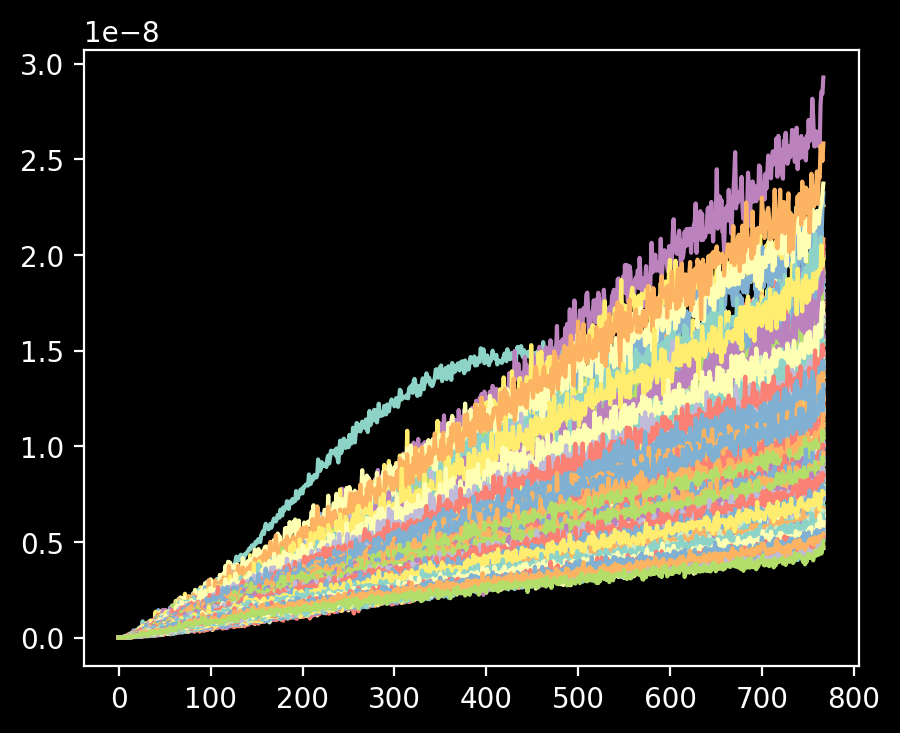

In [1166]:
nx, ny = 1, 1; figsize=4; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
list_high = []
for i in range(len(shells)):
    for j in range(len(shells)):
        cls = list_cls[i,j]
        if cls is not None:
            if np.max(scale_cls(cls)[1]) > 5e-9:
                axl[0].plot(*scale_cls(cls))
                list_high.append((i,j))

list_high = np.array(list_high)
print(len(list_high))
            # axl[0].text(x=len(cls), y=np.max(cls), s=f'{i} {j}')
                        
# cls = hp.alm2cl(hp.map2alm(map_kg))
# axl[0].plot(*scale_cls(cls), lw=5, c='hotpink')
# axl[0].set(yscale='log')

# axl[0].plot(*scale_cls(cls_orig), lw=5, c='dodgerblue')
# axl[0].set(yscale='log')

In [445]:
kg_sc, kg, kd, dg = get_bin_maps(3, smooth_arcmin=16)


In [ ]:
hp.orthview(dg, cmap='coolwarm', bgcolor='black')

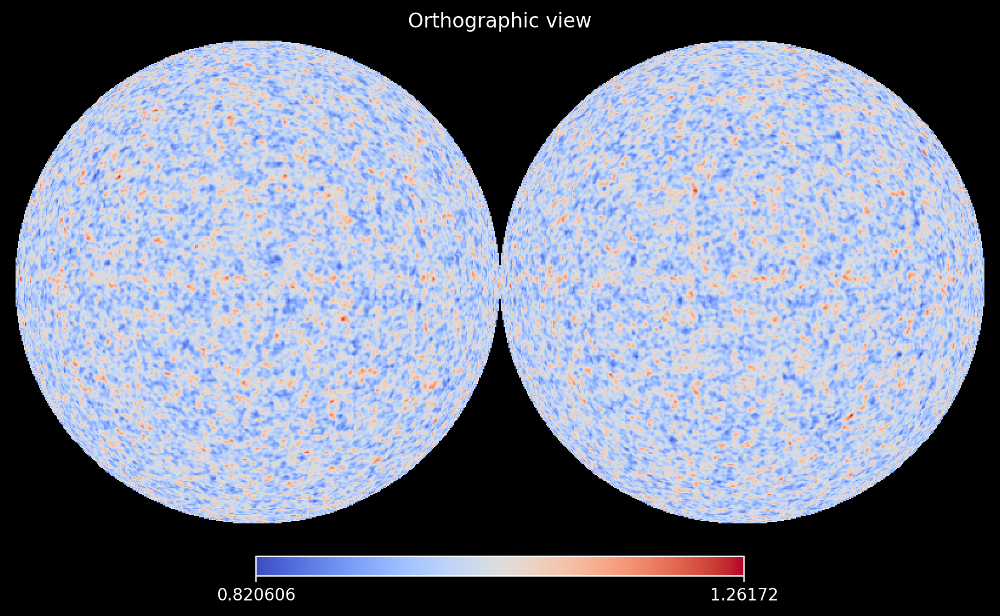

In [446]:
hp.orthview(dg, cmap='coolwarm', bgcolor='black')

/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_33528/2882550675.py:3: RuntimeWarning: divide by zero encountered in log
  hp.orthview(np.log(np.mean(shells[:2], axis=0)), cmap='Spectral_r', bgcolor='black', hold=True, title=f'shell 0')


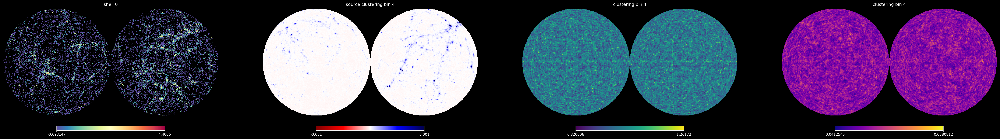

In [461]:
nx, ny = 1, 4; figsize=10; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
plt.axes(axl[0])
hp.orthview(np.log(np.mean(shells[:2], axis=0)), cmap='Spectral_r', bgcolor='black', hold=True, title=f'shell 0')
plt.axes(axl[1])
hp.orthview((kd - np.mean(kd)), cmap='seismic_r', bgcolor='black', min=-0.001, max=0.001, hold=True, title=f'source clustering bin {i+1}')
plt.axes(axl[2])
hp.orthview(dg, cmap='viridis', bgcolor='black', hold=True, title=f'clustering bin {i+1}')
plt.axes(axl[3])
hp.orthview(kg, cmap='plasma', bgcolor='black', hold=True, title=f'clustering bin {i+1}')


In [594]:
maps = [kd - np.mean(kd), dg-1, kg-np.mean(kg)]
for i, m in enumerate(maps):
    hp.write_map(f'm{i}.fits', m, overwrite=True)

setting the output map dtype to [dtype('float64')]
setting the output map dtype to [dtype('float64')]
setting the output map dtype to [dtype('float64')]


/var/folders/96/4c5n4tpd02l_82z2ppsmr5_40000gn/T/ipykernel_33528/89102605.py:8: RuntimeWarning: divide by zero encountered in log
  hp.orthview(np.log(s), cmap='plasma', hold=True, bgcolor='black')


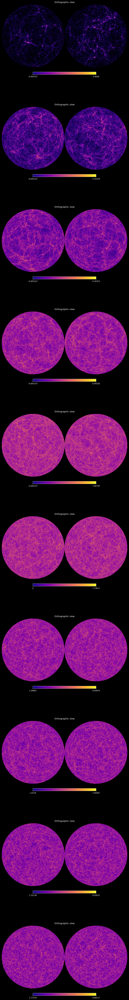

In [410]:
n_shells_plot = 10
n_stack = 2
nx, ny = n_shells_plot, 1; figsize=10; fig, ax  = plt.subplots(nx, ny, figsize=(ny * figsize * 1.25, nx * figsize), squeeze=False); axl=ax.ravel(); axc=ax[0,0];
for i in range(n_shells_plot):
    plt.axes(axl[i])
    si, ei = i*n_stack, (i+1)*n_stack
    s = np.mean(shells[si:ei], axis=0)
    hp.orthview(np.log(s), cmap='plasma', hold=True, bgcolor='black')